In [1]:
from __future__ import print_function

import argparse
import csv
import os
import sys
import tifffile
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import torch
import glob
import pickle

import datetime
import math
import json
import umap
import shap
from sklearn.cluster import KMeans
import plotly.express as px
import time

import timm
from timm.models import create_model
from timm.scheduler import CosineLRScheduler
from timm.optim import create_optimizer
from timm.utils import NativeScaler, get_state_dict

from torch.utils.data import Dataset, random_split, DataLoader
from PIL import Image
import torchvision.models as models
import torchvision.transforms as T
import torch.backends.cudnn as cudnn
import torch.nn.functional as F
import torch.nn as nn
from torchvision.utils import make_grid

import torch.multiprocessing as mp
import torch.distributed as dist
from torch.nn.parallel import DistributedDataParallel as DDP
from torch.utils.data.distributed import DistributedSampler

from customloss import CustomLoss
from datamgr import *
import utils
from engine import *
from dataset import *
from models import *
from samplers import RASampler

import copy
from pathlib import Path
from tqdm import tqdm

2023-12-29 21:42:18.179900: I tensorflow/core/util/port.cc:111] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2023-12-29 21:42:18.181193: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2023-12-29 21:42:18.200937: E tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:9342] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2023-12-29 21:42:18.200953: E tensorflow/compiler/xla/stream_executor/cuda/cuda_fft.cc:609] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2023-12-29 21:42:18.200967: E tensorflow/compiler/xla/stream_executor/cuda/cuda_blas.cc:1518] Unable to register cuBLAS factory: Attempting to regi

In [2]:
train_features = torch.load('./checkpoints/CBNA/CNN/CNN_train_features.pth')
train_df = pd.read_csv('datafile/train_w_covariates_final.csv', sep=',', low_memory=False)
classes = list(np.genfromtxt(Path('datafile/').joinpath('classes.txt'), dtype='str'))
cdref2species = pd.read_csv('filelist/cdref2species.csv')

In [3]:
def encode(target):
    num_cls = len(classes)
    vec = torch.zeros(num_cls)
    label_list = target.split(',')
    for l in label_list:
        idx = classes.index(l)
        vec[idx] = 1
    return vec

def get_label_count(train_df):
    label_cnt = 0
    for i in range(len(train_df)):
        label_onehot = np.array(encode(train_df.iloc[i]['labelset']))
        label_cnt += label_onehot
        
    return label_cnt

def get_invalid_cls(label_cnt, threshold=100):
    cls_idx = np.where(label_cnt<threshold)[0]
    invalid_cls = []
    for i in cls_idx:
        invalid_cls.append(classes[i])
        
    return invalid_cls

def get_new_df(train_df, invalid_cls):
    invalid_idx = []
    for i in range(len(train_df)):
        print('start {}th element'.format(i))
        labelset = train_df.iloc[i]['labelset'].split(',')
        new_labelset = []
        for label in labelset:
            if label not in invalid_cls:
                new_labelset.append(label)
        if len(new_labelset) == 0:
            invalid_idx.append(i)
            print('{}th element is empty'.format(i))
            continue
    
    a = np.arange(len(train_df)).tolist()
    valid_idx = np.setdiff1d(a, invalid_idx)
    
    df = train_df.iloc[valid_idx]
    return df, valid_idx

In [4]:
X = train_features
X = X.numpy()

### UMAP 3d

In [9]:
umap_3d = umap.UMAP(n_components=3, random_state=42)
proj_3d = umap_3d.fit_transform(X)

n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.
The TBB threading layer requires TBB version 2021 update 6 or later i.e., TBB_INTERFACE_VERSION >= 12060. Found TBB_INTERFACE_VERSION = 12050. The TBB threading layer is disabled.


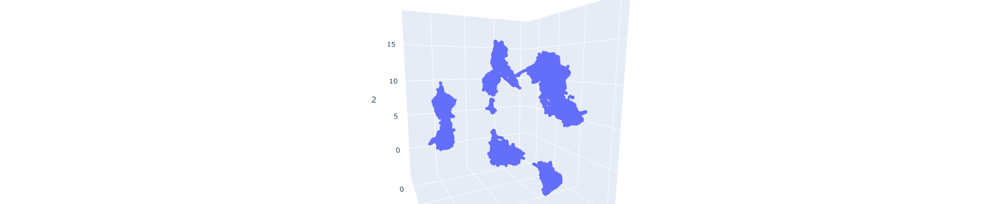

In [32]:
fig_3d = px.scatter_3d(
    proj_3d, x=0, y=1, z=2,
    #color = kmeans.labels_
)

fig_3d.update_traces(marker_size=3)
fig_3d.update_layout(margin=dict(l=0, r=0, b=0, t=0))
fig_3d.show()

### UMAP 2d

In [1]:
#umap_2d = umap.UMAP(n_components=2, random_state=42)
#proj_2d = umap_2d.fit_transform(X)

In [2]:
#fig_2d = px.scatter(
#    proj_2d, x=0, y=1,
#    #color = kmeans.labels_
#)

#fig_2d.update_traces(marker_size=3)
#fig_2d.update_layout(margin=dict(l=0, r=0, b=0, t=0))
#fig_2d.show()

### PCA

In [29]:
from sklearn.decomposition import PCA

pca = PCA(n_components=3, svd_solver='auto', random_state=42)
pca.fit(X)
X_pca = pca.transform(X)

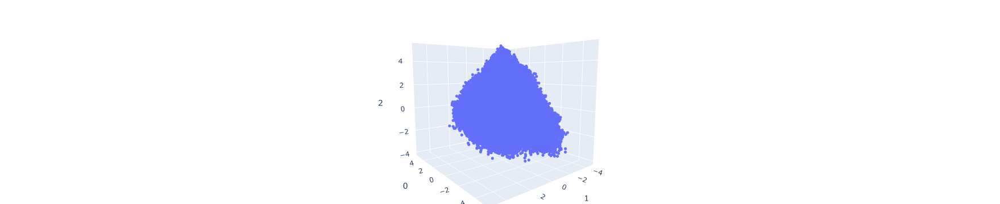

In [30]:
fig_3d = px.scatter_3d(
    X_pca, x=0, y=1, z=2,
    #color = kmeans.labels_
)

fig_3d.update_traces(marker_size=3)
fig_3d.update_layout(margin=dict(l=0, r=0, b=0, t=0))
fig_3d.show()

### Clustering

In [33]:
# function returns WSS score for k values from 1 to kmax
def calculate_WSS(points, kmax):
    sse = []
    for k in tqdm(range(1, kmax+1)):
        kmeans = KMeans(n_clusters = k, random_state=42, n_init="auto").fit(points)
        centroids = kmeans.cluster_centers_
        pred_clusters = kmeans.predict(points)
        curr_sse = 0

        # calculate square of Euclidean distance of each point from its cluster center and add to current WSS
        for i in range(len(points)):
            curr_center = centroids[pred_clusters[i]]
            curr_sse += (points[i, 0] - curr_center[0]) ** 2 + (points[i, 1] - curr_center[1]) ** 2

        sse.append(curr_sse)
        
    return sse

100%|███████████████████████████████████████████| 15/15 [00:04<00:00,  3.55it/s]


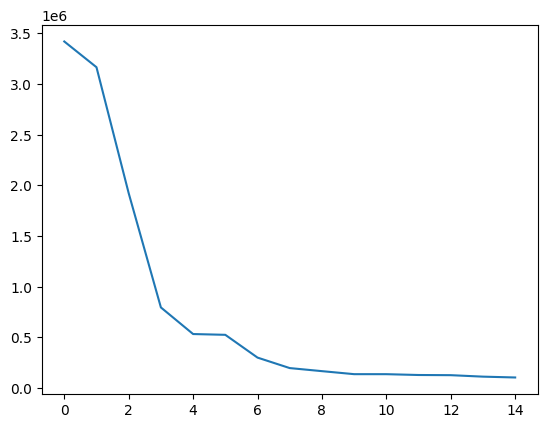

In [34]:
kmax = 15
sse = calculate_WSS(proj_3d, kmax)
plt.plot(sse)

In [47]:
n_clusters=8
kmeans = KMeans(n_clusters=n_clusters, random_state=42, n_init="auto").fit(proj_3d)

In [48]:
def get_target_cnt(n_clusters=8):
    target_cnt = []
    for i in range(n_clusters):
        print('start cluster {}'.format(i))
        target_cnt_k = []
        idx = np.where(kmeans.labels_==i)[0]
        for j in idx:
            target_cnt_k.append(encode(train_df.iloc[j]['labelset']).unsqueeze(0))
        target_cnt_k = torch.cat(target_cnt_k).sum(0, keepdim=True)
        target_cnt.append(target_cnt_k)
    
    target_cnt = torch.cat(target_cnt)
    return target_cnt

def get_cluster4label(target_cnt, threshold):
    cluster = target_cnt.topk(k=1, dim=0)[1]
    percent = target_cnt.topk(k=1, dim=0)[0] / target_cnt.sum(0, keepdim=True)

    label_idx = torch.where(percent.squeeze(0) >= threshold)[0]
    cls_mask = cluster.squeeze(0)[label_idx]
    
    cluster4label = {}
    for i in cls_mask.unique():
        index = torch.where(cls_mask == i.item())[0]
        cluster4label[i.item()] = label_idx[index]
        
    return cluster4label

def get_cluster4label_(target_cnt, num_labels):
    label_cnt, label_idx = target_cnt.topk(k=num_labels, dim=1)
    
    cluster4label = {}
    for i in range(target_cnt.shape[0]):
        cluster4label[i] = label_idx[i]
        
    return cluster4label

def get_info_cluster(target_cnt, threshold, num_labels):
    cluster4label = get_cluster4label_(target_cnt, num_labels)
    save_dict = {}
    for k, v in cluster4label.items():
        cdref = []
        species = []
        print('cluster {}'.format(k))

        idx = np.where(kmeans.labels_==k)[0]
        for i in v:
            cdref.append(float(classes[i.item()]))
        for ref in cdref:
            temp = cdref2species.loc[cdref2species.cd_ref==ref]
            species.append(temp.nom_reconnu.values[0])

        save_dict['cluster_{}'.format(k)] = v
        save_dict['idx_{}'.format(k)] = idx
        save_dict['cdref_{}'.format(k)] = cdref
        save_dict['species_{}'.format(k)] = species
        
    return save_dict

In [49]:
threshold = 0.8
num_labels = 5
target_cnt = get_target_cnt(n_clusters)
save_dict = get_info_cluster(target_cnt, threshold, num_labels)

#torch.save(save_dict, 'visu_onlyimg.pth')

start cluster 0
start cluster 1
start cluster 2
start cluster 3
start cluster 4
start cluster 5
start cluster 6
start cluster 7
cluster 0
cluster 1
cluster 2
cluster 3
cluster 4
cluster 5
cluster 6
cluster 7


In [50]:
def select(save_dict, cluster, num_labels=None, labels=None):
    idx = save_dict['idx_{}'.format(cluster)] 
    res_df = train_df.iloc[idx]
    print('number of images in cluster {}: '.format(cluster), len(res_df))
    cdref_list = save_dict['cdref_{}'.format(cluster)]
    print('number of dominant labels in cluster {}: '.format(cluster), len(cdref_list))
    
    np.random.seed(0)
    
    if labels is None:
        selected_labels = np.unique(np.array(cdref_list)).tolist()
    else:
        selected_labels = labels
    
    if num_labels is not None:
        selected_labels = np.unique(np.random.choice(np.array(cdref_list), num_labels, replace=False)).tolist()

    selected_species = []
    for l in selected_labels:
        species = cdref2species.loc[cdref2species.cd_ref==l].nom_reconnu.values[0]
        selected_species.append(species)

    print('selected dominant labels: ', selected_labels)   
    print('selected dominant species: ', selected_species)

    idx_img = []
    for i in range(len(res_df)):
        for j in selected_labels:
            if str(j) in res_df.iloc[i]['labelset']:
                idx_img.append(res_df.iloc[i]['id_img'])

    idx_img = np.unique(np.array(idx_img)).tolist()
    print('selected images that contain these dominant species: ', len(idx_img))
    
    return selected_labels, selected_species, idx_img

# Select batch_size images for visualization purpose
def get_info_batch(selected_list):
    # Get all other labels other than dominant labels in these images
    all_labels = []
    all_species = []
    temp_df = res_df.loc[res_df.id_img.isin(np.array(selected_list))]

    for i in range(len(temp_df)):
        labelset = temp_df.iloc[i]['labelset'].split(',')
        for j in range(len(labelset)):
            label = float(labelset[j])
            if label not in all_labels:
                all_labels.append(label)
                species = cdref2species.loc[cdref2species.cd_ref==label].nom_reconnu.values[0]
                all_species.append(species)
                
    return all_labels, all_species

def get_batch_imgs(batch_size, idx_img):
    batch_size = min(batch_size, len(idx_img))
    selected_list = np.random.choice(np.array(idx_img), batch_size).tolist()
    data_path = Path('Data/irc_patches/')
    batch_imgs = []

    for j in range(batch_size):
        img_id = selected_list[j]
        img_path = data_path.joinpath('plot%s.tif'%(img_id))
        image = tifffile.imread(img_path)
        image = Image.fromarray(image.astype(np.uint8).transpose(1,2,0))
        batch_imgs.append(transforms.ToTensor()(image).unsqueeze(0))

    batch_imgs = torch.cat(batch_imgs)
    #print(batch_imgs.shape)
    return batch_imgs, selected_list

## Cluster Visualization

In [51]:
def cluster_visu(batch_size, cluster=1, num_labels=5, labels=None):
    selected_labels, selected_species, idx_img = select(save_dict, cluster, num_labels, labels)
    batch_imgs, selected_list = get_batch_imgs(batch_size, idx_img)

    fig, ax = plt.subplots(figsize=(16, 16))
    ax.set_xticks([]); ax.set_yticks([])
    ax.imshow(make_grid(batch_imgs, nrow=min(batch_size, batch_size//8)).permute(1, 2, 0))
    
    return selected_labels, selected_species, idx_img

In [52]:
def prepare_illu_data(idx_img):
    df = train_df.loc[train_df.id_img.isin(idx_img)]
    features = ['x_l93', 'y_l93'] + meta_features
    res_df = df[features]
    
    return df, res_df

def prepare_shap_data(res_df, num_train_data=None, num_test_data=3):
    eff_num = res_df.shape[0] - num_test_data
    if (num_train_data is None) or (num_train_data>eff_num):
        num_train_data = eff_num
    
    choices = np.random.choice(res_df.shape[0], res_df.shape[0], replace=False)
    train_data = torch.tensor(res_df[meta_features].values).float()[choices[0:num_train_data]]
    train_data = (train_data - meta_stats['mean'].float()) / meta_stats['std'].float()
    train_data = train_data.to(args.device)

    idx_test = choices[num_train_data:num_train_data+num_test_data]
    test_data = torch.tensor(res_df[meta_features].values).float()[idx_test]
    test_data = (test_data - meta_stats['mean'].float()) / meta_stats['std'].float()
    test_data = test_data.to(args.device)
    
    return train_data, test_data, idx_test

def compute_shap(model, train_data, test_data, selected_labels):
    explainer = shap.DeepExplainer(model, train_data)
    shap_values = explainer.shap_values(test_data)
    
    shap_mean = 0.0
    shap_cls = []
    explain_cls = []
    cdref = list(map(str, selected_labels))
    for ref in cdref:
        idx = args.classes.index(ref)
        shap_cls.append(shap_values[idx])
        explain_cls.append(explainer.expected_value[idx])
        shap_mean = shap_mean + shap_values[idx]

    shap_mean = shap_mean / len(cdref)
    
    return shap_cls, explain_cls, shap_mean

def compute_emd(res_df1, res_df2):
    n_features = res_df1.shape[1]
    a = res_df1.values
    b = res_df2.values
    
    emds = []
    for i in range(17):
        emd_val = emd_samples(a[:,i], b[:,i])
        emds.append(emd_val)
        
    return np.array(emds), np.mean(emds)

def show_sample(df, idx, args):
    row = df.iloc[idx]
    img_id, target = row['id_img'], row['labelset']

    data_path = args.data_path + 'plot%s.tif'%(img_id)
    image = tifffile.imread(data_path)
    image = Image.fromarray(image.astype(np.uint8).transpose(1,2,0))

    plt.imshow(image)
    #print(target)

number of images in cluster 2:  17744
number of dominant labels in cluster 2:  5
selected dominant labels:  [86512.0, 92606.0, 94207.0, 97947.0, 98921.0]
selected dominant species:  ['Bromopsis erecta (Huds.) Fourr., 1869', 'Corylus avellana L., 1753', 'Dactylis glomerata L., 1753', 'Fagus sylvatica L., 1753', 'Fraxinus excelsior L., 1753']
selected images that contain these dominant species:  10530


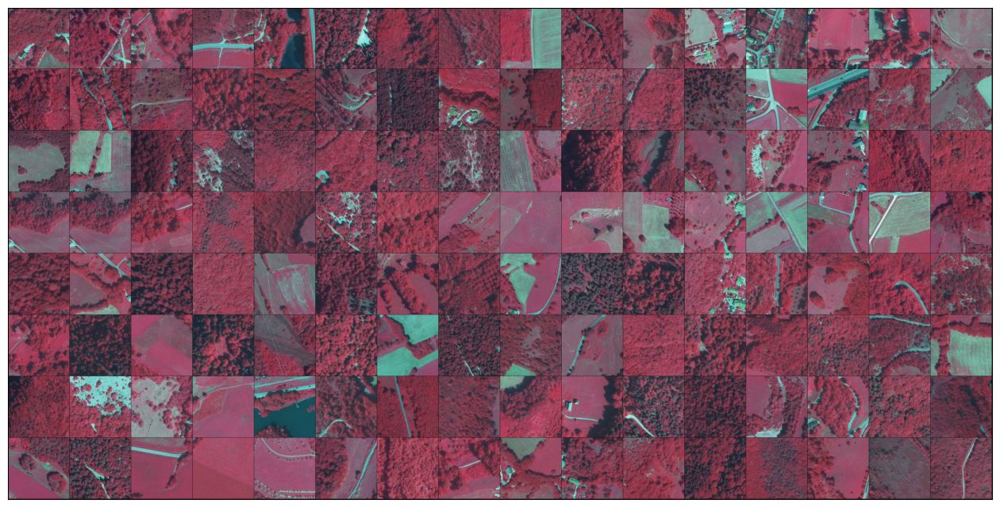

In [55]:
batch_size=128
selected_labels, selected_species, idx_img = cluster_visu(batch_size, cluster=2, num_labels=None, labels=None)